In [1]:
import tensorflow as tf
from tensorflow.keras import layers, Model
from tensorflow.keras.optimizers import Adam

import tensorflow_datasets as tfds

import numpy as np
import matplotlib.pyplot as plt

In [2]:
path = 'c:/Users/admin/Desktop/Dunhuang_dataset/'

train_images = tf.keras.utils.image_dataset_from_directory(path, image_size=(512, 512), batch_size=16)

Found 416 files belonging to 2 classes.


In [3]:
train_images

<BatchDataset element_spec=(TensorSpec(shape=(None, 512, 512, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

In [4]:
for x, y in train_images.take(1):
    print(x.shape)

(16, 512, 512, 3)


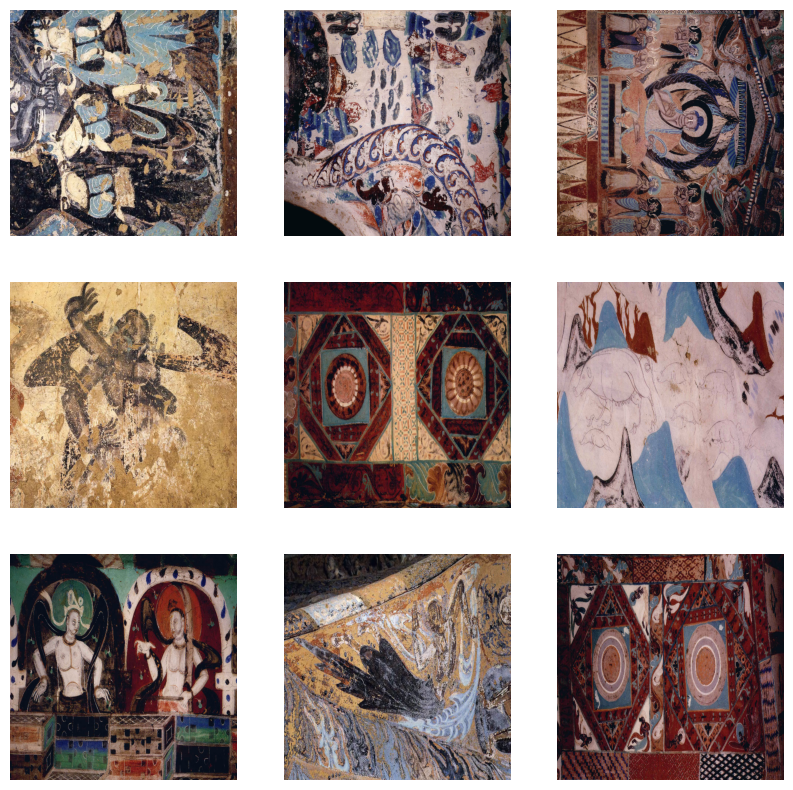

In [5]:
plt.figure(figsize=(10, 10))
for images, labels in train_images.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.axis("off")

In [6]:
normalization_layer = layers.Rescaling(1./255)
normalized_train_images = train_images.map(lambda x, y: (normalization_layer(x), y))
image_batch, labels_batch = next(iter(normalized_train_images))
first_image = image_batch[0]
# Notice the pixel values are now in `[0,1]`.
print(np.min(first_image), np.max(first_image))

0.0 0.9421529


In [7]:
image_shape = (512, 512, 3)
batch_size = 16

In [8]:
class WGAN_GP():
    def __init__(self, input_shape):

        self.z_dim = 64
        self.input_shape = input_shape

        self.loss_critic = {}
        self.loss_gp = {}
        self.loss_generator = {}
        
        # critic
        self.n_critic = 5
        self.penalty_const = 10
        self.critic = self.build_critic()
        self.critic.trainable = False

        self.optimizer_critic = Adam(1e-4, 0.5, 0.9)

        # build generator pipeline with frozen critic
        self.generator = self.build_generator()
        critic_output = self.critic(self.generator.output)
        self.model = Model(self.generator.input, critic_output)
        self.model.compile(loss = self.wasserstein_loss,
                           optimizer = Adam(1e-4, 0.5, 0.9))
        self.critic.trainable = True
        
    def wasserstein_loss(self, y_true, y_pred):

        w_loss = -tf.reduce_mean(y_true*y_pred)

        return w_loss

    def build_generator(self):

        DIM = 64
        model = tf.keras.Sequential(name='Generator') 

        model.add(layers.Input(shape=[self.z_dim])) 

        model.add(layers.Dense(16*16*8*DIM))                                                
        model.add(layers.LayerNormalization()) 
        model.add(layers.ReLU())
        model.add(layers.Reshape((16,16,8*DIM)))                                            
        
        model.add(layers.UpSampling2D((2,2), interpolation="bilinear"))               
        model.add(layers.Conv2D(8*DIM, 5, padding='same'))                                
        model.add(layers.LayerNormalization()) 
        model.add(layers.ReLU())
        
        model.add(layers.UpSampling2D((2,2), interpolation="bilinear"))               
        model.add(layers.Conv2D(4*DIM, 5, padding='same'))                                
        model.add(layers.LayerNormalization()) 
        model.add(layers.ReLU())
        
        model.add(layers.UpSampling2D((2,2), interpolation="bilinear"))                    
        model.add(layers.Conv2D(2*DIM, 5, padding='same'))                                 
        model.add(layers.LayerNormalization()) 
        model.add(layers.ReLU())
        
        model.add(layers.UpSampling2D((2,2), interpolation="bilinear"))                 
        model.add(layers.Conv2D(DIM, 5, padding='same'))                              
        model.add(layers.LayerNormalization()) 
        model.add(layers.ReLU())

        model.add(layers.UpSampling2D((2,2), interpolation="bilinear"))                   
        model.add(layers.Conv2D(image_shape[-1], 5, padding='same', activation='tanh'))   

        return model             
    
    def build_critic(self):

        DIM = 64
        model = tf.keras.Sequential(name='critics') 

        model.add(layers.Input(shape=self.input_shape)) 

        model.add(layers.Conv2D(1*DIM, 5, strides=2, padding='same', use_bias=False))    
        model.add(layers.LeakyReLU(0.2))

        model.add(layers.Conv2D(2*DIM, 5, strides=2, padding='same', use_bias=False))
        model.add(layers.LeakyReLU(0.2))

        model.add(layers.Conv2D(4*DIM, 5, strides=2, padding='same', use_bias=False))
        model.add(layers.LeakyReLU(0.2))

        model.add(layers.Conv2D(8*DIM, 5, strides=2, padding='same', use_bias=False))
        model.add(layers.LeakyReLU(0.2))
        
        model.add(layers.Conv2D(16*DIM, 5, strides=2, padding='same', use_bias=False))
        model.add(layers.LeakyReLU(0.2))
        
        model.add(layers.Conv2D(32*DIM, 5, strides=2, padding='same', use_bias=False))
        model.add(layers.LeakyReLU(0.2))
        
        model.add(layers.Conv2D(64*DIM, 5, strides=2, padding='same', use_bias=False))
        model.add(layers.LeakyReLU(0.2))
     
        model.add(layers.Flatten()) 
        model.add(layers.Dense(1)) 

        return model     
    
 
    def gradient_loss(self, grad):

        loss = tf.square(grad)
        loss = tf.reduce_sum(loss, axis=np.arange(1,len(loss.shape)))
        loss = tf.sqrt(loss)
        loss = tf.reduce_mean(tf.square(loss - 1))
        loss = self.penalty_const * loss
        return loss

    def train_critic(self, real_images, batch_size):
        real_labels = tf.ones(batch_size)
        fake_labels = -tf.ones(batch_size)
                  
        g_input = tf.random.normal((batch_size, self.z_dim))
        fake_images = self.generator.predict(g_input, verbose=0)
        
        with tf.GradientTape() as gradient_tape,\
             tf.GradientTape() as total_tape:
            
            # forward pass
            pred_fake = self.critic(fake_images)
            pred_real = self.critic(real_images)
            
            # calculate losses
            loss_fake = self.wasserstein_loss(fake_labels, pred_fake)
            loss_real = self.wasserstein_loss(real_labels, pred_real)           
            
            # gradient penalty      
            epsilon = tf.random.uniform((batch_size,1,1,1))
            interpolates = epsilon*real_images + (1-epsilon)*fake_images
            gradient_tape.watch(interpolates)
            
            critic_interpolates = self.critic(interpolates)
            gradients_interpolates = gradient_tape.gradient(critic_interpolates, [interpolates])
            gradient_penalty = self.gradient_loss(gradients_interpolates)
     
            # total loss
            total_loss = loss_fake + loss_real + gradient_penalty
            
            # apply gradients
            gradients = total_tape.gradient(total_loss, self.critic.trainable_variables)
            
            self.optimizer_critic.apply_gradients(zip(gradients, self.critic.trainable_variables))

        return loss_fake, loss_real, gradient_penalty
                                                
    def train(self, data_generator, batch_size, steps, interval=100):

        val_g_input = tf.random.normal((batch_size, self.z_dim))
        real_labels = tf.ones(batch_size)

        for i in range(steps):
            for _ in range(self.n_critic):
                real_images = data_generator
                loss_fake, loss_real, gradient_penalty = self.train_critic(real_images, batch_size)
                critic_loss = loss_fake + loss_real
            # train generator
            g_input = tf.random.normal((batch_size, self.z_dim))
            g_loss = self.model.train_on_batch(g_input, real_labels)
            self.loss_gp[i] = gradient_penalty
            self.loss_critic[i] = critic_loss.numpy()
            self.loss_generator[i] = g_loss
            if i%interval == 0:
                msg = "Step {}: g_loss {:.4f} critic_loss {:.4f} critic fake {:.4f}  critic_real {:.4f} penalty {:.4f}"\
                .format(i, g_loss, critic_loss, loss_fake, loss_real, gradient_penalty)
                print(msg)

                fake_images = self.generator.predict(val_g_input, verbose=0)
                self.plot_images(fake_images)
                # self.plot_losses()

    def plot_images(self, images):   
        grid_row = 1
        grid_col = 6
        f, axarr = plt.subplots(grid_row, grid_col, figsize=(grid_col*3.5, grid_row*3.5))
        for row in range(grid_row):
            for col in range(grid_col):
                if self.input_shape[-1]==1:
                    axarr[col].imshow(images[col,:,:,0]*0.5+0.5, cmap='gray')
                else:
                    axarr[col].imshow(images[col]*0.5+0.5)
                axarr[col].axis('off') 
        plt.show()

    def plot_losses(self):
        fig, (ax1, ax2, ax3) = plt.subplots(3, sharex=True)
        fig.set_figwidth(10)
        fig.set_figheight(6)
        ax1.plot(list(self.loss_critic.values()), label='Critic loss', alpha=0.7)
        ax1.set_title("Critic loss")
        ax2.plot(list(self.loss_generator.values()), label='Generator loss', alpha=0.7)
        ax2.set_title("Generator loss")
        ax3.plot(list(self.loss_gp.values()), label='Gradient penalty', alpha=0.7)
        ax3.set_title("Gradient penalty")
        plt.xlabel('Steps')
        plt.show()

In [9]:
wgan = WGAN_GP(image_shape)

Step 0: g_loss 334.5440 critic_loss -1144.4915 critic fake -667.4465  critic_real -477.0450 penalty 947.7886


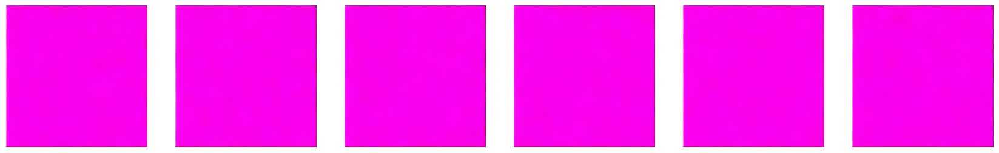

Step 100: g_loss 105.0992 critic_loss -120.4853 critic fake -116.4104  critic_real -4.0749 penalty 35.3593


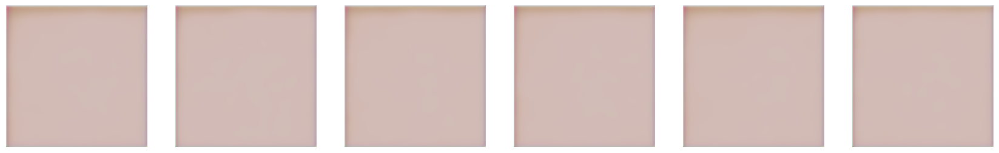

Step 200: g_loss 37.9747 critic_loss -89.9287 critic fake -53.5461  critic_real -36.3826 penalty 24.4112


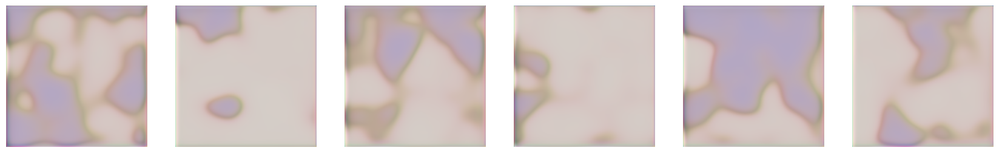

Step 300: g_loss -55.5410 critic_loss -78.5451 critic fake -49.2650  critic_real -29.2801 penalty 28.3032


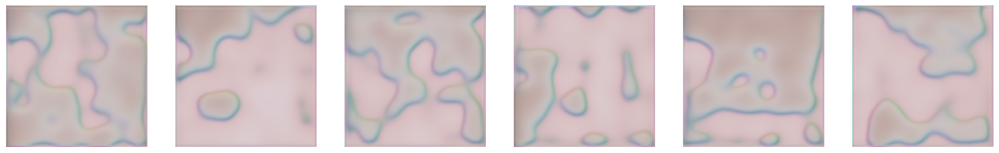

Step 400: g_loss -14.6953 critic_loss -121.3401 critic fake 28.5632  critic_real -149.9033 penalty 46.5099


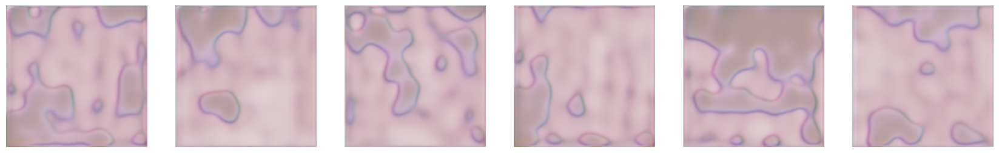

Step 500: g_loss 83.7649 critic_loss -116.0155 critic fake -97.0498  critic_real -18.9657 penalty 31.1418


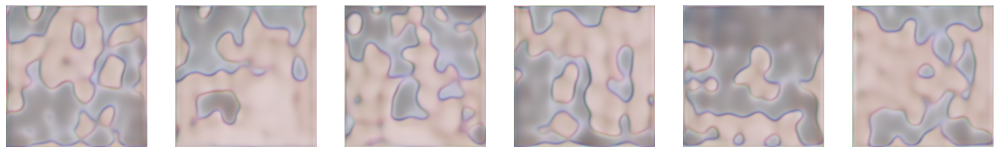

Step 600: g_loss 3.8783 critic_loss -118.1748 critic fake -9.9179  critic_real -108.2569 penalty 35.2671


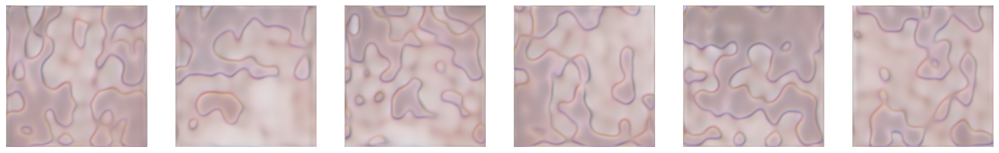

Step 700: g_loss 65.1917 critic_loss -121.4859 critic fake -77.0542  critic_real -44.4317 penalty 42.9833


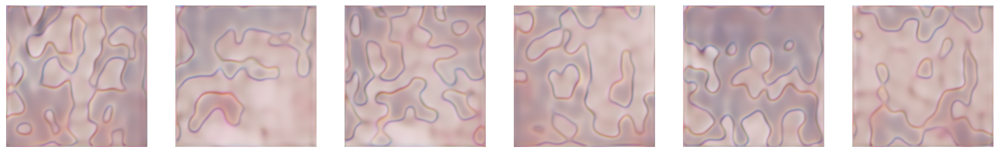

Step 800: g_loss 2.7993 critic_loss -111.4327 critic fake -4.7637  critic_real -106.6690 penalty 30.5298


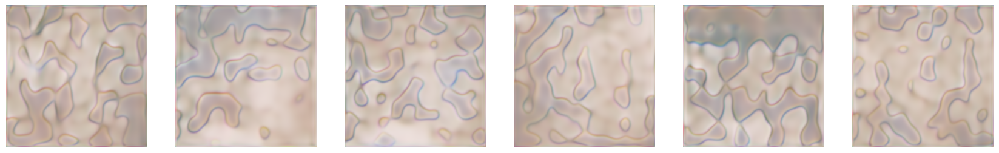

Step 900: g_loss -9.6695 critic_loss -114.3412 critic fake 13.7922  critic_real -128.1333 penalty 36.7599


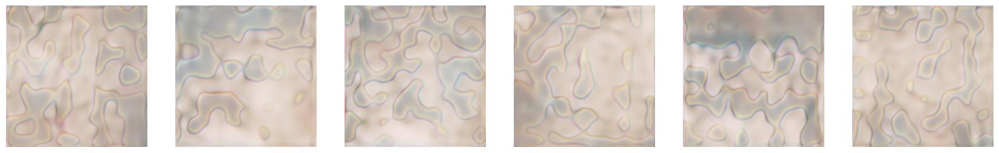

Step 1000: g_loss -7.4823 critic_loss -114.1607 critic fake 1.7252  critic_real -115.8859 penalty 34.0317


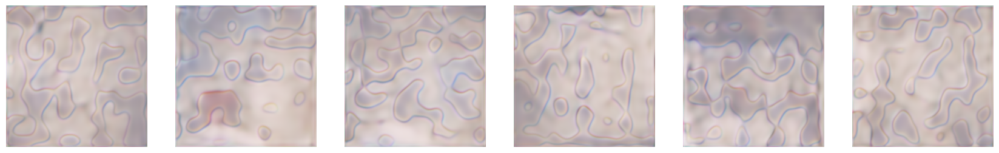

Step 1100: g_loss 9.6817 critic_loss -112.0029 critic fake 0.0871  critic_real -112.0900 penalty 41.2817


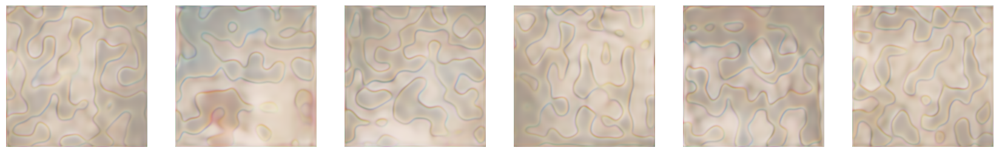

Step 1200: g_loss 17.9135 critic_loss -106.8708 critic fake -21.0959  critic_real -85.7749 penalty 33.5545


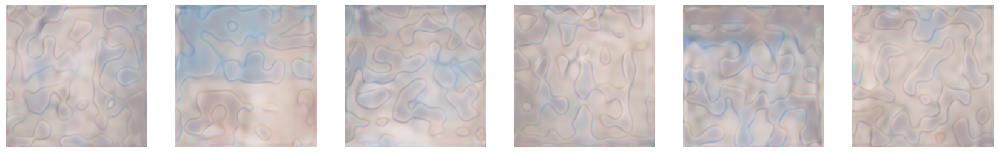

Step 1300: g_loss 15.2211 critic_loss -107.6106 critic fake -23.2218  critic_real -84.3888 penalty 36.7854


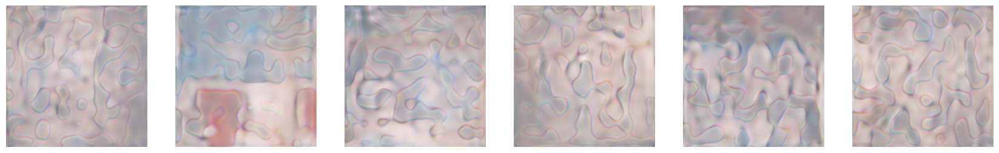

Step 1400: g_loss 13.7394 critic_loss -104.6070 critic fake -1.5492  critic_real -103.0578 penalty 34.6344


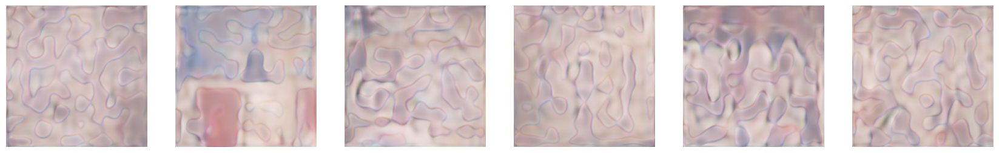

Step 1500: g_loss -2.0861 critic_loss -106.7958 critic fake -2.7528  critic_real -104.0430 penalty 35.1138


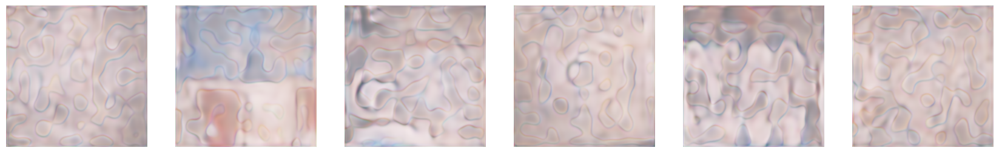

Step 1600: g_loss -6.2394 critic_loss -100.8843 critic fake 3.0584  critic_real -103.9426 penalty 29.9609


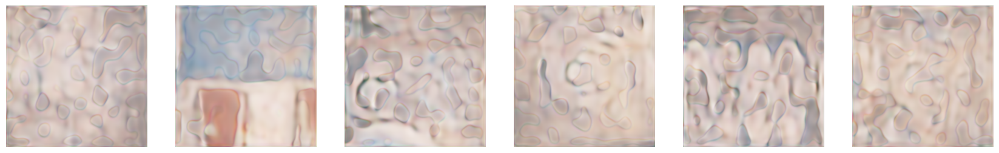

Step 1700: g_loss 3.2821 critic_loss -104.9562 critic fake 1.2268  critic_real -106.1830 penalty 35.2989


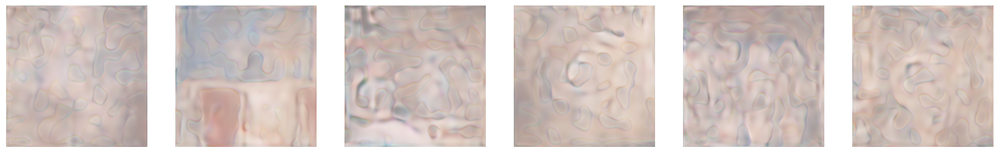

Step 1800: g_loss -7.4780 critic_loss -109.8817 critic fake 9.6493  critic_real -119.5311 penalty 43.0289


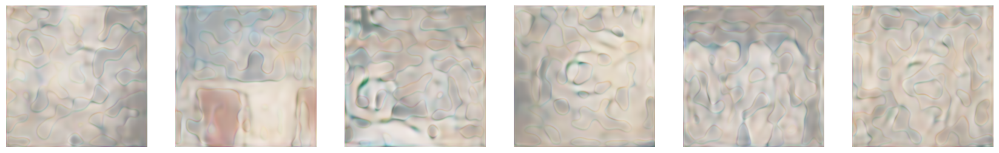

Step 1900: g_loss 2.1192 critic_loss -107.4315 critic fake -2.3585  critic_real -105.0730 penalty 44.7328


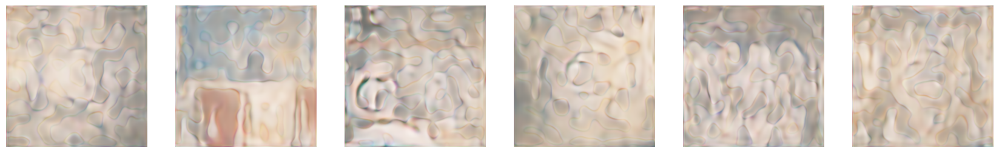

Step 2000: g_loss -2.5775 critic_loss -101.8087 critic fake -1.0156  critic_real -100.7931 penalty 30.0809


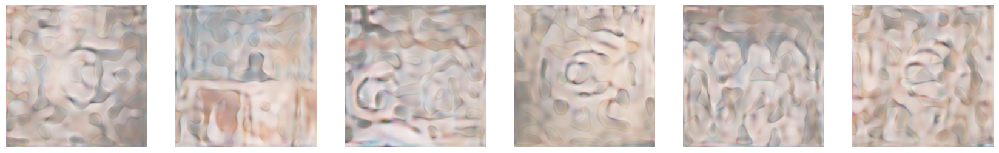

Step 2100: g_loss 4.8520 critic_loss -101.5381 critic fake -12.2485  critic_real -89.2896 penalty 28.2126


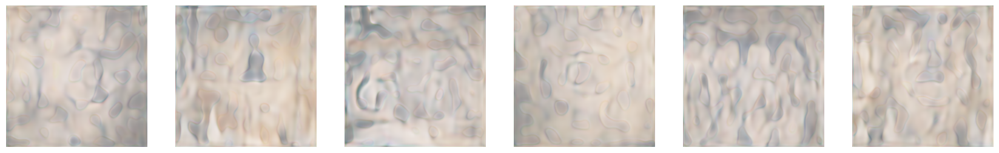

Step 2200: g_loss 5.5795 critic_loss -104.5010 critic fake -10.5887  critic_real -93.9123 penalty 34.5342


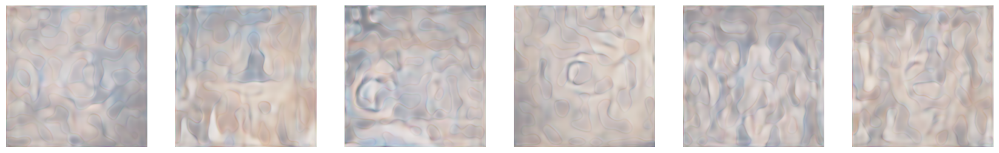

Step 2300: g_loss 5.8390 critic_loss -99.7767 critic fake -8.2953  critic_real -91.4814 penalty 24.1892


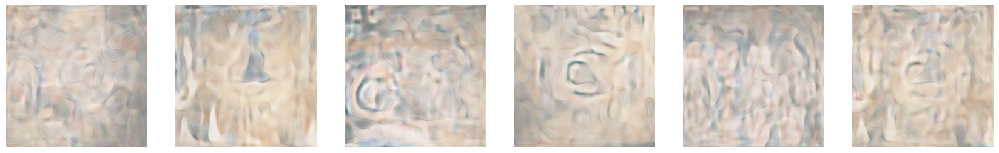

Step 2400: g_loss -2.6646 critic_loss -98.8461 critic fake 3.2215  critic_real -102.0677 penalty 33.6501


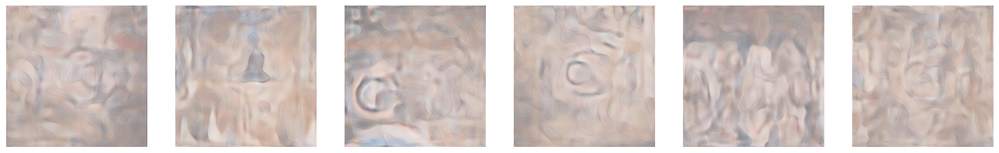

Step 2500: g_loss -4.3207 critic_loss -99.4512 critic fake -1.9355  critic_real -97.5158 penalty 31.8727


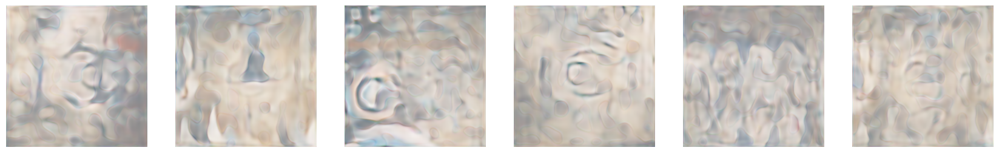

Step 2600: g_loss -1.8740 critic_loss -98.0667 critic fake -6.7373  critic_real -91.3293 penalty 17.7813


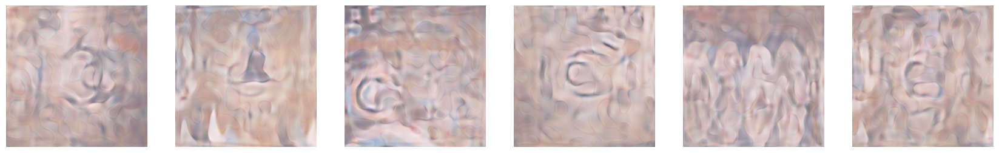

Step 2700: g_loss -2.6097 critic_loss -104.8552 critic fake 2.0865  critic_real -106.9417 penalty 34.4671


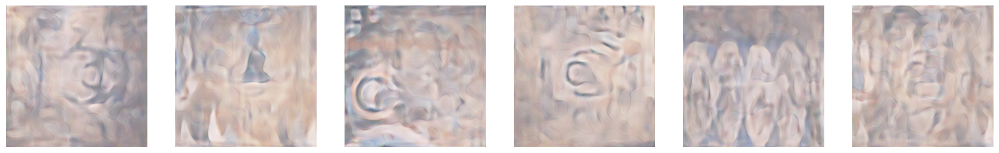

Step 2800: g_loss 16.8340 critic_loss -94.5492 critic fake -6.7668  critic_real -87.7824 penalty 27.8964


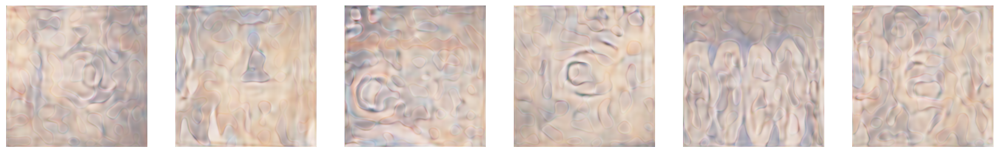

Step 2900: g_loss 2.5727 critic_loss -101.2089 critic fake 1.0062  critic_real -102.2151 penalty 38.5756


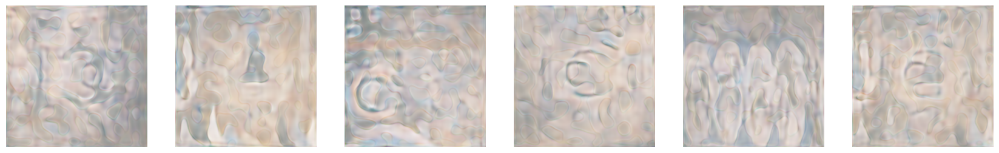

Step 3000: g_loss 2.5994 critic_loss -96.5252 critic fake -1.5286  critic_real -94.9966 penalty 32.4308


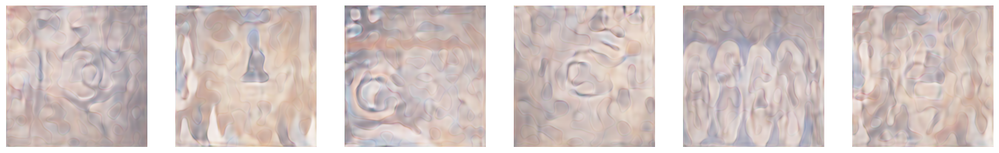

Step 3100: g_loss 3.4082 critic_loss -99.8151 critic fake -2.8129  critic_real -97.0023 penalty 31.2569


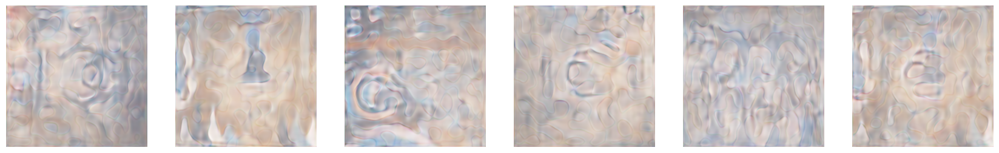

Step 3200: g_loss 2.5284 critic_loss -101.5737 critic fake -5.3900  critic_real -96.1837 penalty 37.7361


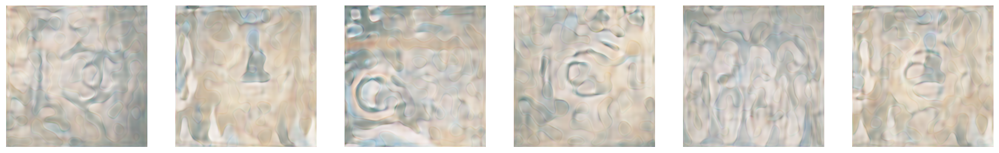

Step 3300: g_loss -3.0413 critic_loss -102.9207 critic fake 2.6688  critic_real -105.5894 penalty 25.8391


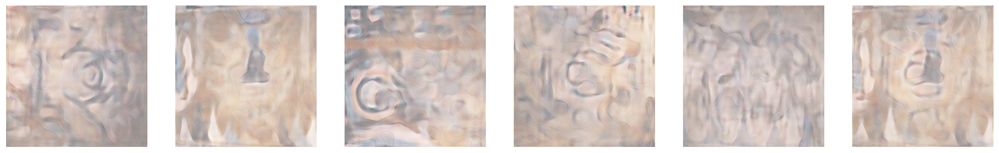

Step 3400: g_loss -0.4296 critic_loss -104.6855 critic fake -5.6060  critic_real -99.0796 penalty 40.5928


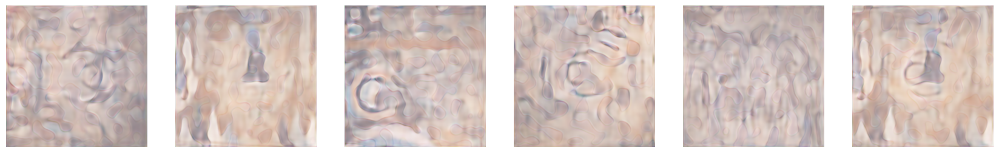

Step 3500: g_loss 10.1159 critic_loss -99.3710 critic fake -4.7798  critic_real -94.5913 penalty 37.5538


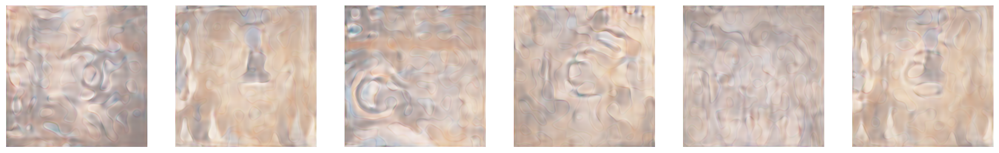

Step 3600: g_loss 0.6587 critic_loss -96.5310 critic fake 6.9751  critic_real -103.5062 penalty 40.8317


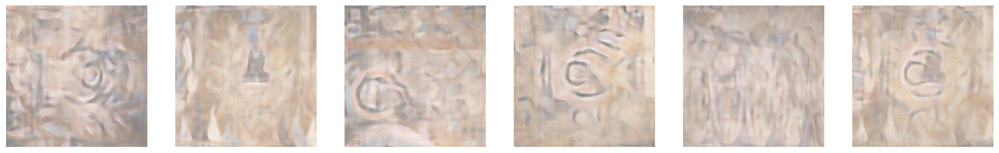

Step 3700: g_loss -5.4349 critic_loss -88.7618 critic fake 3.2237  critic_real -91.9855 penalty 24.8607


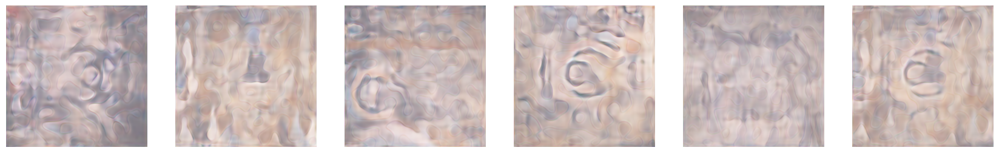

Step 3800: g_loss -0.1842 critic_loss -101.8797 critic fake 0.9293  critic_real -102.8090 penalty 41.8685


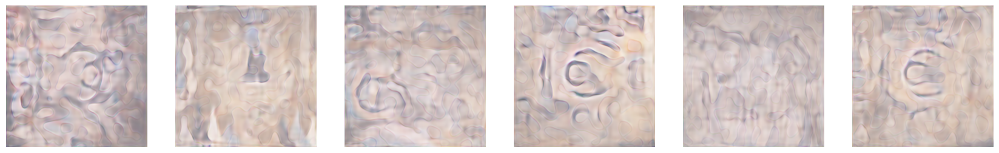

Step 3900: g_loss 4.8431 critic_loss -92.5729 critic fake -6.4749  critic_real -86.0980 penalty 36.3427


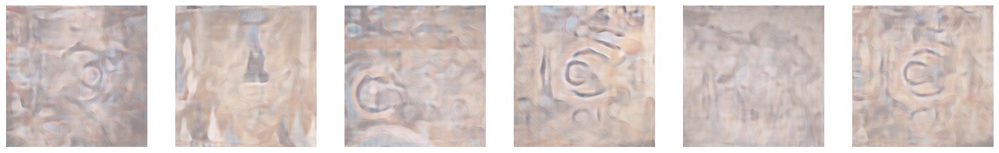

Step 4000: g_loss -4.0926 critic_loss -89.3782 critic fake -0.8411  critic_real -88.5371 penalty 28.0541


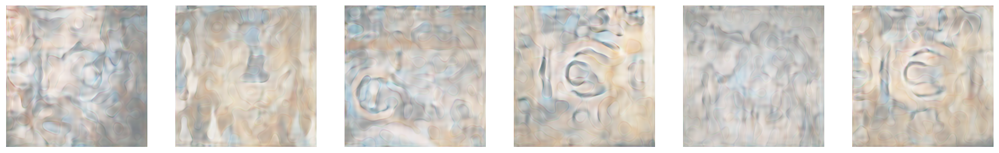

Step 4100: g_loss 4.7182 critic_loss -89.0704 critic fake -6.1813  critic_real -82.8891 penalty 25.7435


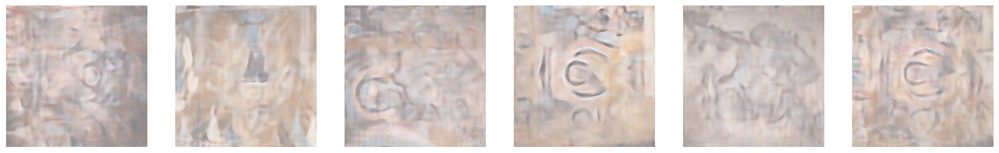

Step 4200: g_loss 1.4738 critic_loss -88.4176 critic fake 4.8826  critic_real -93.3002 penalty 28.7329


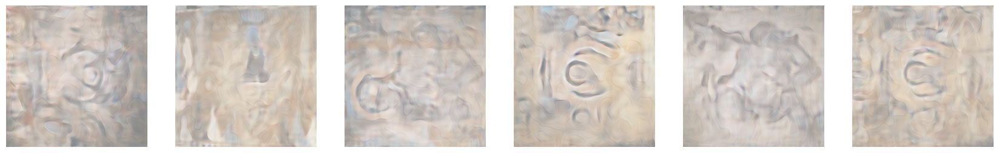

Step 4300: g_loss 4.7815 critic_loss -91.4612 critic fake -0.8824  critic_real -90.5788 penalty 27.5221


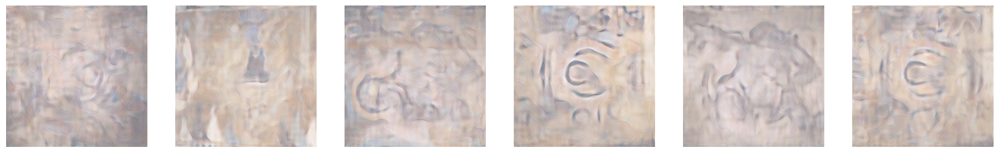

Step 4400: g_loss -11.0405 critic_loss -89.3296 critic fake 7.4253  critic_real -96.7548 penalty 24.2361


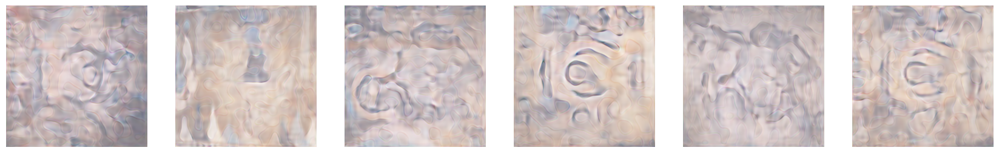

Step 4500: g_loss 0.5350 critic_loss -97.3284 critic fake -0.5450  critic_real -96.7833 penalty 40.7106


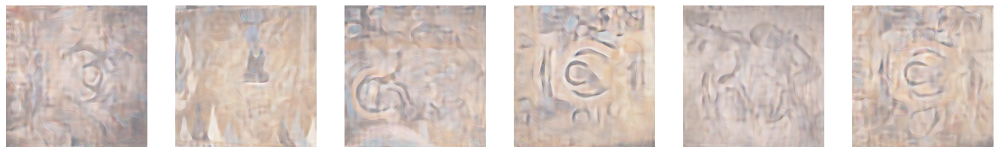

Step 4600: g_loss -6.4417 critic_loss -97.2947 critic fake 1.0000  critic_real -98.2947 penalty 29.3586


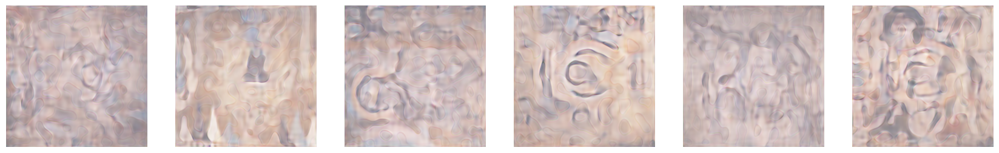

Step 4700: g_loss 1.2580 critic_loss -95.4025 critic fake -2.6450  critic_real -92.7575 penalty 31.6155


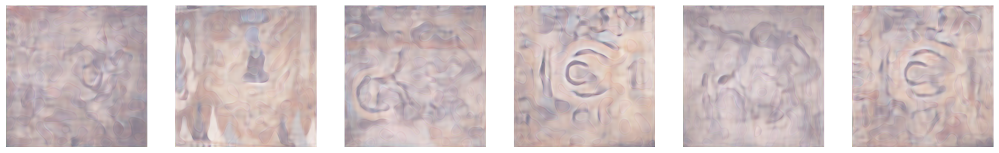

Step 4800: g_loss -1.2254 critic_loss -96.3694 critic fake 1.2580  critic_real -97.6274 penalty 32.3389


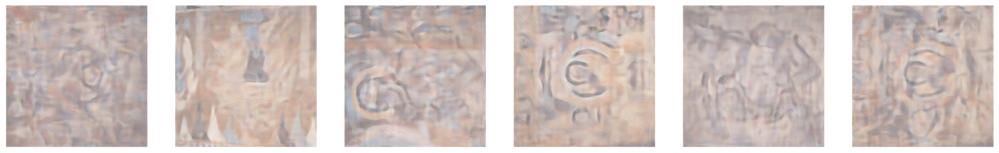

Step 4900: g_loss -0.5511 critic_loss -95.3222 critic fake 5.5406  critic_real -100.8628 penalty 22.8872


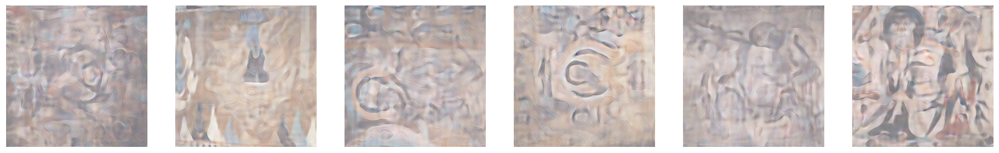

Step 5000: g_loss -4.8797 critic_loss -96.7758 critic fake 0.0431  critic_real -96.8189 penalty 28.8375


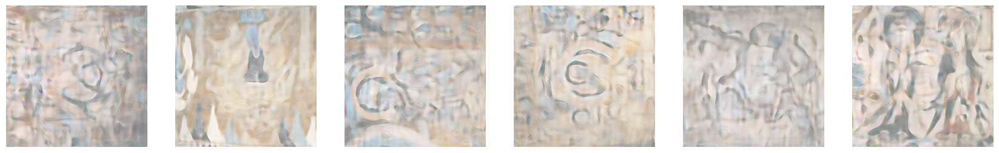

Step 5100: g_loss 3.4745 critic_loss -83.7700 critic fake -6.4454  critic_real -77.3246 penalty 17.1357


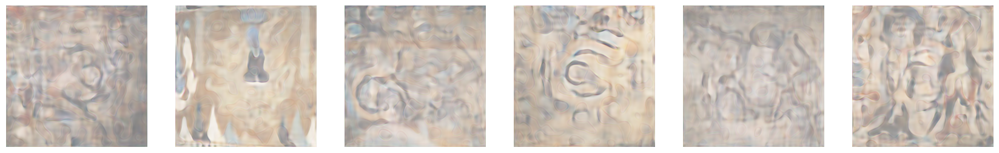

Step 5200: g_loss -1.5875 critic_loss -88.4445 critic fake -0.0231  critic_real -88.4214 penalty 22.0092


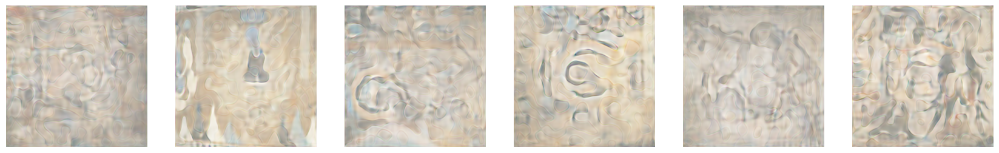

Step 5300: g_loss 1.1896 critic_loss -96.0723 critic fake -2.6810  critic_real -93.3913 penalty 34.3044


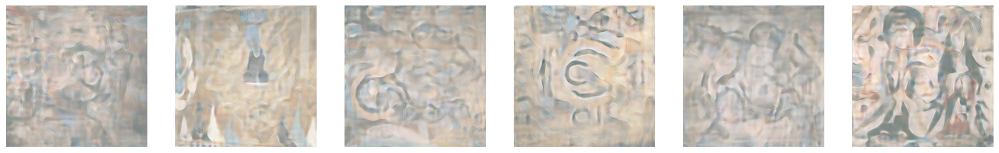

Step 5400: g_loss 2.9486 critic_loss -91.3853 critic fake -1.0582  critic_real -90.3271 penalty 26.7691


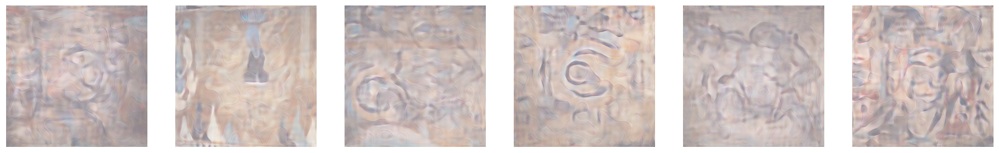

Step 5500: g_loss 2.0462 critic_loss -96.7744 critic fake -0.0434  critic_real -96.7311 penalty 43.0961


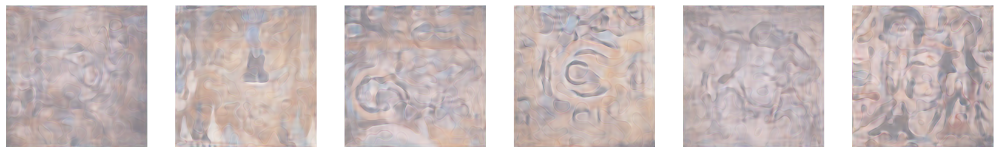

Step 5600: g_loss 8.6923 critic_loss -87.2134 critic fake -10.1176  critic_real -77.0959 penalty 24.7568


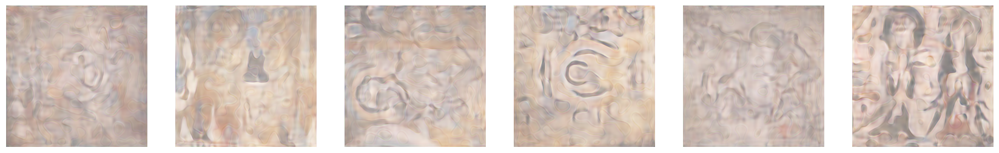

Step 5700: g_loss -0.5627 critic_loss -87.8759 critic fake 0.8303  critic_real -88.7063 penalty 31.6525


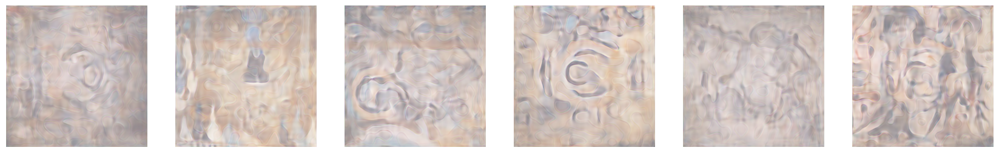

Step 5800: g_loss -6.2803 critic_loss -84.5747 critic fake 0.7256  critic_real -85.3004 penalty 20.5534


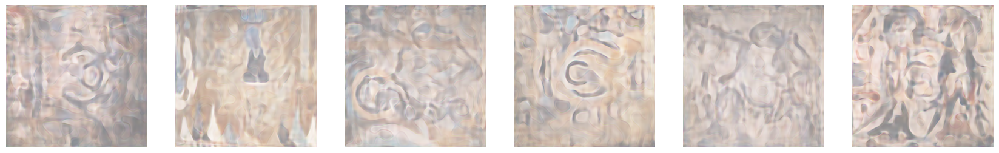

Step 5900: g_loss -4.3098 critic_loss -90.0555 critic fake -3.8692  critic_real -86.1864 penalty 17.4038


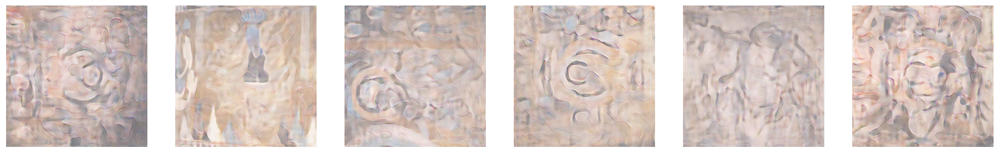

Step 6000: g_loss 8.0654 critic_loss -92.5405 critic fake -5.3355  critic_real -87.2050 penalty 35.9179


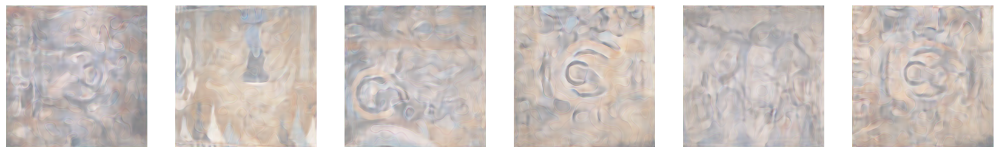

Step 6100: g_loss -0.6787 critic_loss -88.8642 critic fake 4.5447  critic_real -93.4089 penalty 36.8157


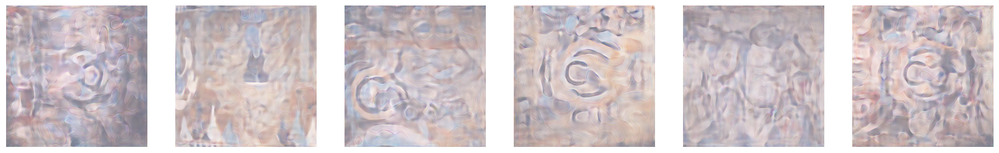

Step 6200: g_loss -2.5555 critic_loss -88.3333 critic fake -1.8064  critic_real -86.5270 penalty 45.9665


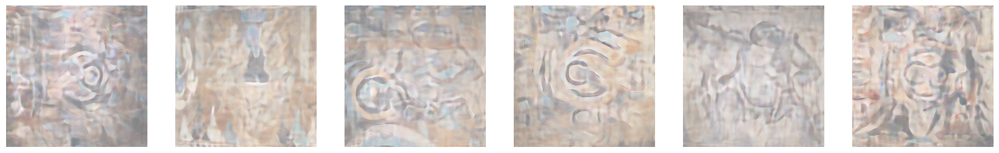

Step 6300: g_loss -5.6963 critic_loss -77.3721 critic fake 1.3183  critic_real -78.6904 penalty 21.9030


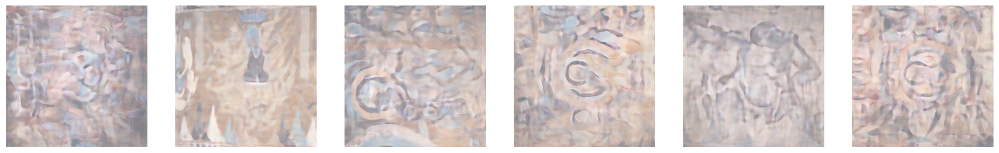

Step 6400: g_loss 12.1796 critic_loss -90.2265 critic fake -5.4948  critic_real -84.7317 penalty 28.7941


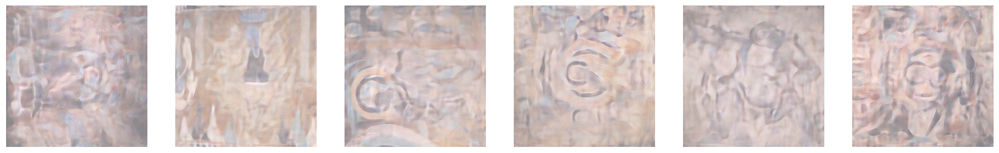

Step 6500: g_loss -5.7198 critic_loss -84.6345 critic fake 4.0760  critic_real -88.7105 penalty 17.0897


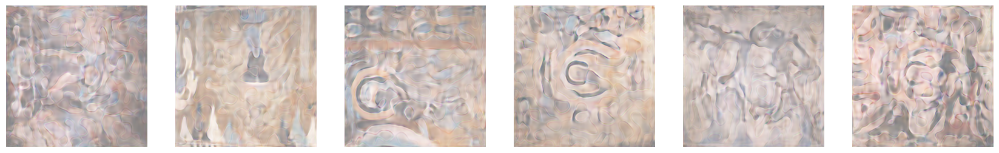

Step 6600: g_loss 5.2979 critic_loss -85.3748 critic fake -4.1575  critic_real -81.2174 penalty 30.4334


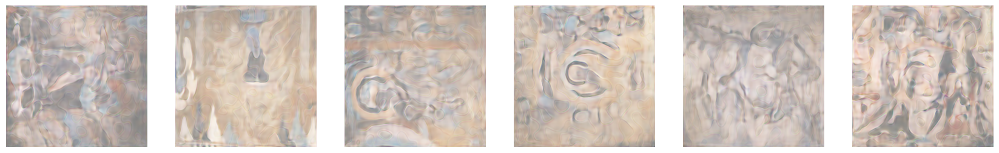

Step 6700: g_loss 12.9489 critic_loss -91.6760 critic fake 0.2353  critic_real -91.9113 penalty 31.2757


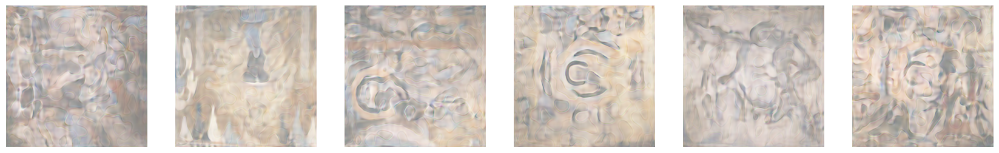

Step 6800: g_loss -1.2303 critic_loss -87.3178 critic fake -4.8474  critic_real -82.4703 penalty 29.5832


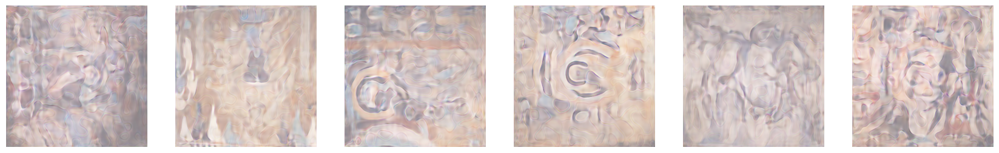

Step 6900: g_loss -1.2506 critic_loss -84.2925 critic fake 1.2072  critic_real -85.4998 penalty 18.8515


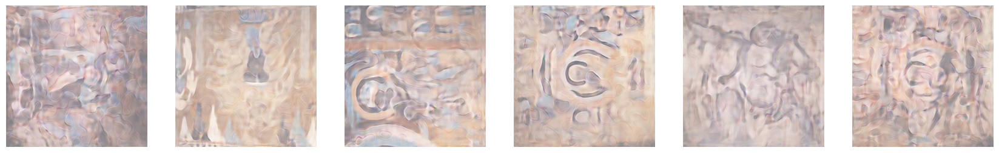

Step 7000: g_loss -0.0296 critic_loss -87.3420 critic fake 2.2745  critic_real -89.6165 penalty 20.2511


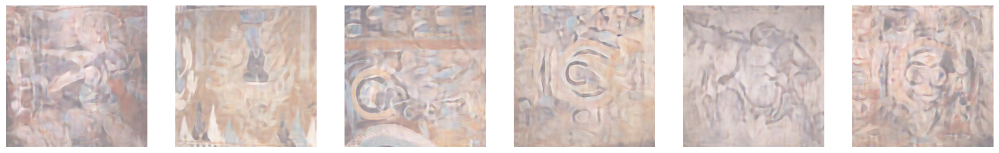

Step 7100: g_loss 9.5228 critic_loss -88.8004 critic fake -5.1450  critic_real -83.6554 penalty 17.2263


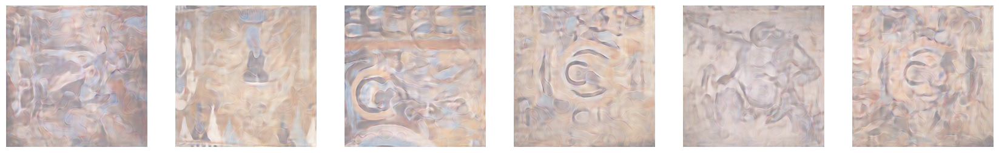

Step 7200: g_loss 3.4729 critic_loss -83.9977 critic fake -2.4738  critic_real -81.5239 penalty 48.7009


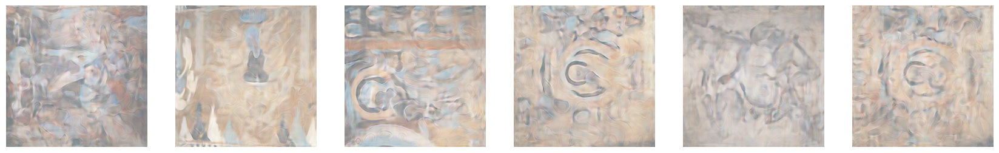

Step 7300: g_loss 5.3631 critic_loss -78.2073 critic fake -1.0642  critic_real -77.1431 penalty 20.6701


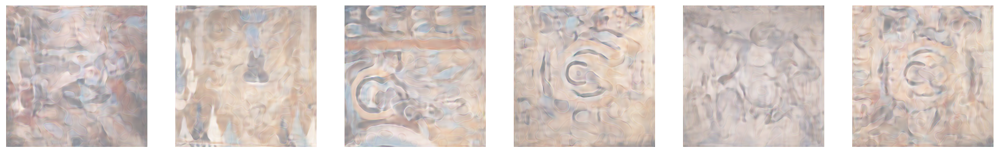

KeyboardInterrupt: 

In [10]:
wgan.train(image_batch, 16, 50000, 100)

In [ ]:
wgan.train(image_batch, 16, 50000, 100)

In [ ]:
wgan.model.summary()

In [ ]:
wgan.generator.summary()

In [ ]:
wgan.critic.summary()

In [ ]:
z = tf.random.normal((8, 64))
generated_images = wgan.generator.predict(z)
wgan.plot_images(generated_images)

In [ ]:
for i in range(20):
    z = tf.random.normal((20, 64))
    images = wgan.generator.predict(z, verbose=0)
    
    grid_row = 1
    grid_col = 20
    f, axarr = plt.subplots(grid_row, grid_col, figsize=(grid_col*3.5, grid_row*3.5))
    for row in range(grid_row):
        for col in range(grid_col):
            axarr[col].imshow(images[col]*0.5+0.5)
            axarr[col].axis('off')
    plt.show()

In [11]:
wgan.generator.save_weights('wgan_gp_dunhuang_512_7300.weights')

Load model and interpolate

In [ ]:
wgan.generator.load_weights('wgan_gp_dunhuang_512_.weights')

1/1 [==============================] - 1s 598ms/step


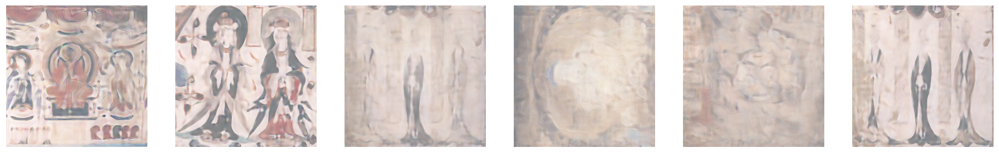

In [14]:
z = tf.random.normal((6, 64))
generated_images = wgan.generator.predict(z)
wgan.plot_images(generated_images)

In [ ]:
for i in range(20):
    z = tf.random.normal((20, 64))
    images = wgan.generator.predict(z, verbose=0)
    
    grid_row = 1
    grid_col = 20
    f, axarr = plt.subplots(grid_row, grid_col, figsize=(grid_col*4, grid_row*4))
    for row in range(grid_row):
        for col in range(grid_col):
            axarr[col].imshow(images[col]*0.5+0.5)
            axarr[col].axis('off')
    plt.show()

In [16]:
def interpolate_points(p1, p2, n_steps=10):
# interpolate ratios between the points
    ratios = np.linspace(0, 1, num=n_steps)
# linear interpolate vectors
    vectors = list()
    for ratio in ratios:
        v = (1.0 - ratio) * p1 + ratio * p2
        vectors.append(v)
    return np.asarray(vectors)

In [17]:
def plot_generated(images, n):
    plt.figure(figsize=(100,100))
    for i in range(n):
        plt.subplot(1, n, 1+i)
        plt.axis('off')
        plt.imshow(images[i,:,:]*0.5+0.5)
    plt.show()

In [90]:
def save_generated(images, n, name):
    plt.figure(figsize=(100,100))
    for i in range(n):
        plt.clf()
        plt.axis('off')
        plt.imshow(images[i,:,:]*0.5+0.5)
        plt.savefig('./dunhuang/image_{}_{}.jpg'.format(name, i))

In [58]:
points = (np.random.randn(7*64)).reshape((7,64))

In [77]:
interpolated = interpolate_points(points[0], points[1],120)

In [78]:
images = wgan.generator.predict(tf.convert_to_tensor(interpolated))

4/4 [==============================] - 1s 441ms/step


In [ ]:
plot_generated(images, 120)

In [ ]:
save_generated(images, 120, 'first')

In [81]:
interpolated = interpolate_points(points[1], points[2],120)

In [82]:
images = wgan.generator.predict(tf.convert_to_tensor(interpolated))

4/4 [==============================] - 1s 366ms/step


In [ ]:
plot_generated(images, 120)

In [ ]:
save_generated(images, 120, 'second')

In [86]:
interpolated = interpolate_points(points[2], points[3],120)

In [87]:
images = wgan.generator.predict(tf.convert_to_tensor(interpolated))

4/4 [==============================] - 1s 415ms/step


In [ ]:
plot_generated(images, 120)

In [ ]:
save_generated(images, 120, 'third')

In [92]:
interpolated = interpolate_points(points[3], points[4],120)

In [93]:
images = wgan.generator.predict(tf.convert_to_tensor(interpolated))

4/4 [==============================] - 1s 455ms/step


In [ ]:
plot_generated(images, 120)

In [ ]:
save_generated(images, 120, 'fourth')

In [96]:
interpolated = interpolate_points(points[4], points[5],120)

In [97]:
images = wgan.generator.predict(tf.convert_to_tensor(interpolated))

4/4 [==============================] - 1s 445ms/step


In [ ]:
plot_generated(images, 120)

In [ ]:
save_generated(images, 120, 'fifth')

In [100]:
interpolated = interpolate_points(points[5], points[6],120)

In [101]:
images = wgan.generator.predict(tf.convert_to_tensor(interpolated))

4/4 [==============================] - 1s 442ms/step


In [ ]:
plot_generated(images, 120)

In [ ]:
save_generated(images, 120, 'sixth')